## Addressing Decision Paralysis in Online Book Shopping

The saying goes "Don't Judge a book by it's cover" But Why? Anyone who shops at a local bookstore is definitely paying attention to the covers. And from personal experience, it is a key determinant on whether I end up purchasing a book.



## Approaches to Image Similarity in Computer Vision

Research into computer vision techniques for mining images data for visually similar content led me to Pinterest's [visual search tool](https://medium.com/cracking-the-data-science-interview/pinterests-visual-lens-how-computer-vision-explores-your-taste-47d591b42d7c), that among other tools, heavily utilizes Pre-trained deep learning models for object detection.

## Object Detection

Initially, I attempted object detection of some romance book covers, but the approach was too slow with less than promising results. See the object detections files for the results.

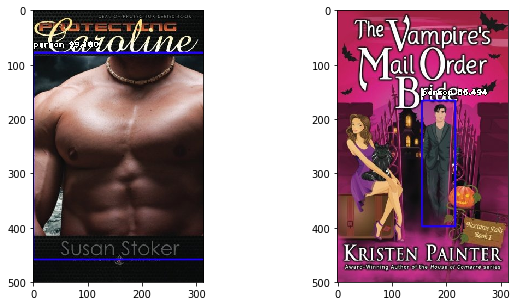

In [2]:
import os
import matplotlib.pyplot as plt
import cv2

img1 = cv2.imread('image_detections/romance_detection/40-0990738809.jpg')
img2 = cv2.imread('image_detections/romance_detection/40-1941695078.jpg')

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)

plt.imshow(img1)

plt.subplot(1, 2, 2)
plt.imshow(img2)
plt.show()

## The problem with a basic object detection approach

A 'person' object class was detected in both cases but these covers are clearly not visually similar.
Pinterest's visual search tool addresses this problem by incorporating other information on top of object detection however, attempting to replicate the complexity of their search tool is impractical given the already heavy computational cost of running object detection models on a large number of images

## Returning to the business problem

### How to address Decision Paralysis to Online Book shopping

Drawing upon my own experience as a life-long lover of brick and mortar Independent Book Stores I had an inkling that the driving force behind spontaneous book store purchases had more to do with people's **aesthetic preferences** for cover art than obsessively reading over plot blurbs and author testimonials on the back cover. 

## Aesthetics and accounting for 'taste' in cover art

The problem with incorporating aesthetics into a model is that, similar to the problem of assigning a rating to a book's story, aesthetics is an **inherently personal preference** tied directly to the consumer's **experience** of the product.

If we can start to filter covers down to more relevent samples, a reccomendation sysem driven by user feedback weighting will allow the system to 'learn' a person's aesthetic preferences over time.

To achieve this, we turn to similarity based Pattern-Recognition techniques and utilize user-submitted images to filter reccommendations based on Color Histogram Comparisons and Structural Similarity Index (SSIM) Scores.



# Cover to Cover Reccomender system
The following is an implementation of a content based Image Retrieval system using 2-level filtering with comparing color histgrams (with OpenCV)  and computing Structural Similary Index scores (with Sci-kit-image) between a user subitted-image and specified genre of book covers

In [3]:
from skimage.measure import compare_ssim as ssim
import numpy as np
import pandas as pd

In [4]:
def load_hist_data(root_dir, sub_dirs, random_samples=False):
    color_hist_data = []
   
    for genre in sub_dirs:
        image_directory = root_dir + genre
        #print(image_directory)
        image_files = os.listdir(image_directory)
        #print(image_files)
        
        
        if random_samples == False: #load data for all images
            for file in image_files:
                path = os.path.join(image_directory, file)

                image = cv2.imread(path)

                if image is None:
                    continue
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                # extract a RGB color histogram from the image,
                # using 8 bins per channel, normalize, and update
                # the index
                hist = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8],[0, 256, 0, 256, 0, 256])
                hist = cv2.normalize(hist, None)
                color_hist_data.append((path,hist))
                
        else: # generate random sample 
            np.random.shuffle(image_files)
            for file in image_files[:1000]:
                path = os.path.join(image_directory, file)

                image = cv2.imread(path)

                if image is None:
                    continue
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                # extract a RGB color histogram from the image,
                # using 8 bins per channel, normalize, and update
                # the index
                hist = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8],[0, 256, 0, 256, 0, 256])
                hist = cv2.normalize(hist, None)
                color_hist_data.append((path,hist))
                
                
    data_size = len(color_hist_data)
    print('{} images loaded'.format(data_size))
    return color_hist_data

In [5]:
def get_similarity_index(query_path,other_path): # read in images to compare in grayscale, resize to same dimensions, run ssim 
    
    query_img = cv2.imread(query_path,0)
    query_img = cv2.resize(query_img,(8,8))
    
    other_img = cv2.imread(other_path,0)
    other_img = cv2.resize(other_img,(8,8))
    
    return ssim(query_img,other_img)



In [11]:
def submit_img(path, images_to_compare, intersect_min=.75, intersect_max=80, ssim_max_threshold=None, results = None):    
    """Function takes an input image and batch of images to compare against input. Returns 25 images sorted according to 
2-level filter, first measuring Histogram similarity, then results are ranked based on Structural Similarity Index """
    
    query = []

    query_img = cv2.imread(path)
    query_img = cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB)
    
    hist = cv2.calcHist([query_img], [0, 1, 2], None, [8, 8, 8],[0, 256, 0, 256, 0, 256])
    hist = cv2.normalize(hist, None)


    query.append((path,hist))
    

    color_matches = []
    
    for i in range(len(query)):
        sim_filter = []
        
        for j in range(len(images_to_compare)):
            cmp = cv2.compareHist(query[i][1], images_to_compare[j][1], cv2.HISTCMP_CHISQR)
            
            if cmp <= intersect_max:
                sim_filter.append((cmp,images_to_compare[j][0]))
                
        sim_filter.sort(key=lambda x : x[0] , reverse = False)# the lower the chi_sq the better
        color_matches.append((query[i][0], sim_filter))

    
    final_matches = []

    for i in range(len(color_matches)):
        query_image_path = color_matches[i][0]
        sim_filter = []
        for j in range(len(color_matches[i][1])):
            match_image_path = color_matches[i][1][j][1]

            si = get_similarity_index(query_image_path,match_image_path)
            
            if ssim_max_threshold:
                if si <= ssim_max_threshold:
                    color_sim_score = color_matches[i][1][j][0]

                    sim_filter.append((si, color_sim_score, match_image_path))
            
            else:
                if si > 0:
                    color_sim_score = color_matches[i][1][j][0]

                    sim_filter.append((si, color_sim_score, match_image_path))
        
        
        
        sim_filter.sort(key=lambda x : x[0], reverse = True)

        start = int(input("enter starting results index "))
        final_matches_limit = start + 20
        final_matches.append((query_image_path,sim_filter[start:final_matches_limit]))
    
    
    
    for i, match in enumerate(final_matches[0][1]):
        recc = cv2.imread(match[2])

        recc = cv2.cvtColor(recc, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.title('Result {}:'.format(i+1))
        plt.imshow(query_img)

        plt.subplot(1, 2, 2)
        plt.title("SSIM {:.2f}, intersect coef {:.2f} ".format(match[0],match[1]))
        plt.imshow(recc)
        
        if results: #store results in dict for furthering filtering
            results[str(i+1)] = match[2]

In [12]:
#data = load_hist_data('images/train_set/', ['SciFi-Fantasy'])
data = load_hist_data('images/fiction-books/', ['Literature & Fiction'], random_samples=True)

998 images loaded


enter starting results index 0


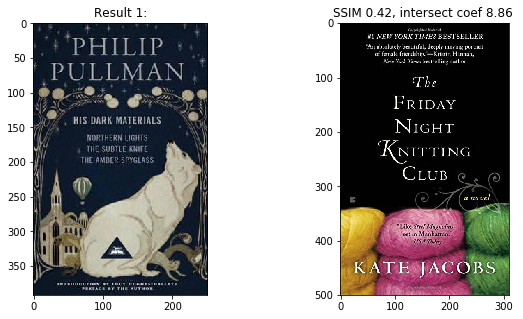

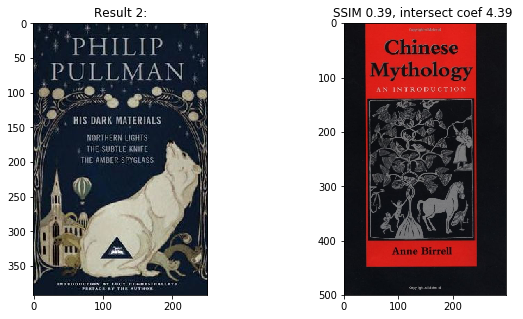

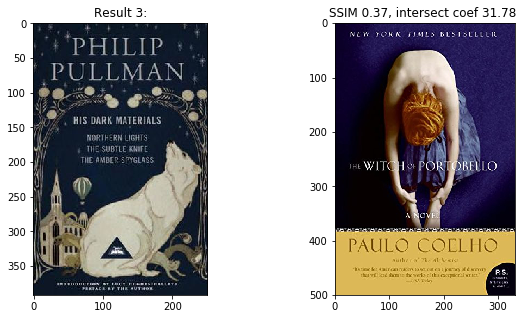

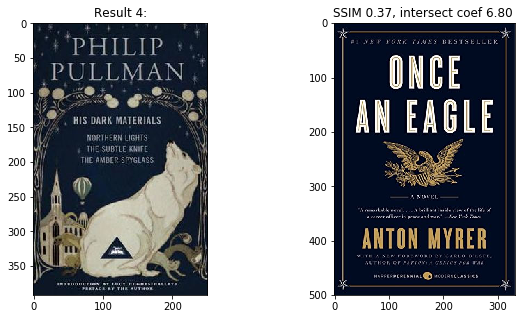

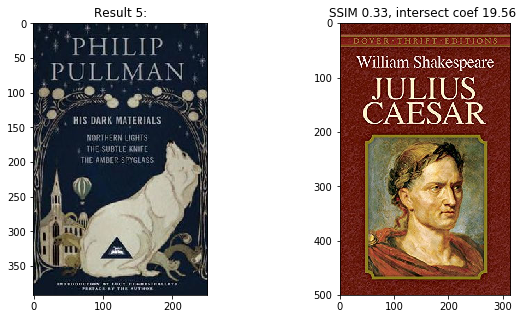

...

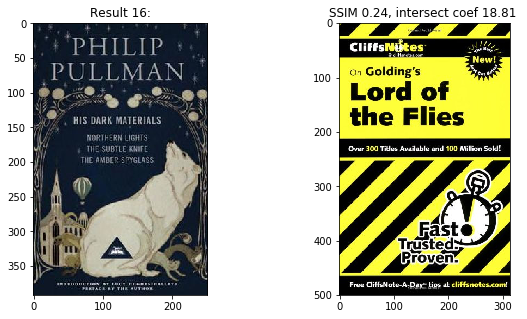

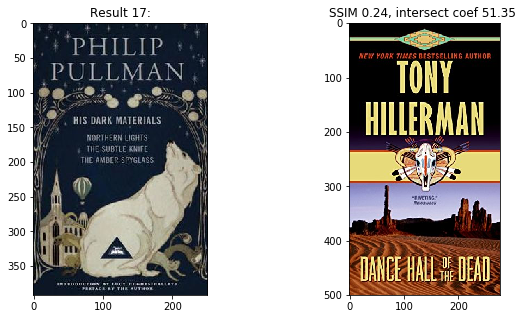

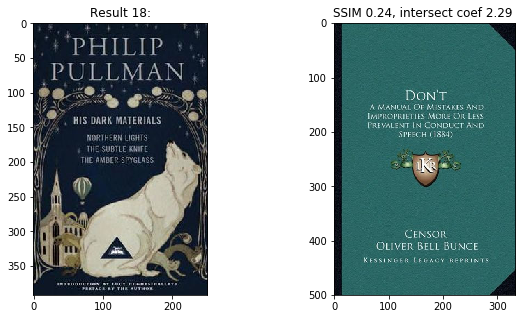

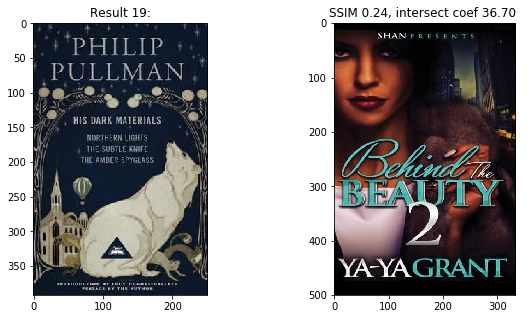

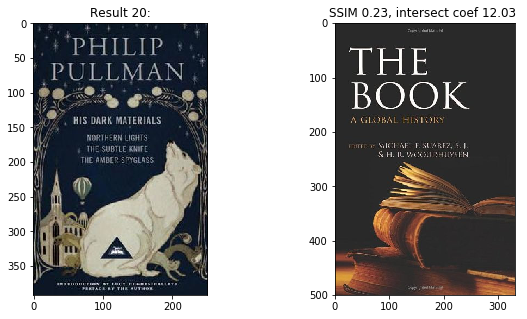

In [85]:
submit_img(test_path, data)

enter starting results index 0


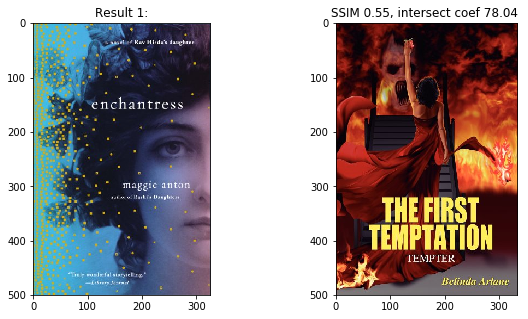

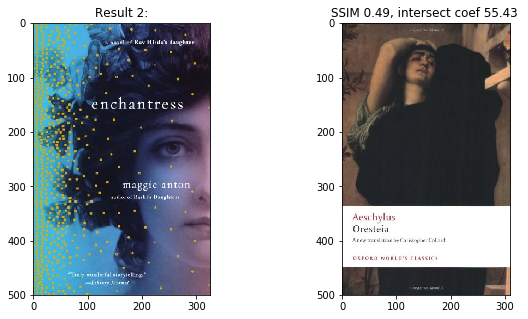

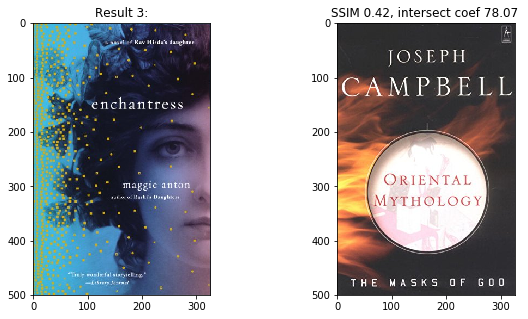

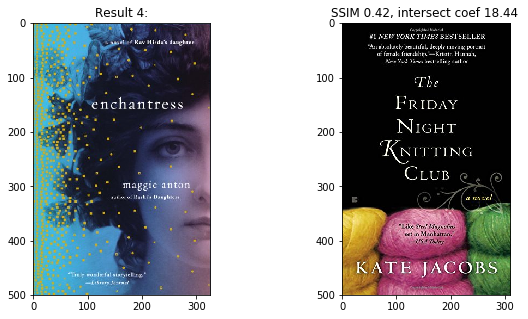

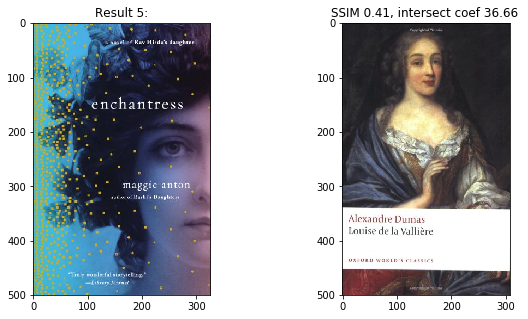

...

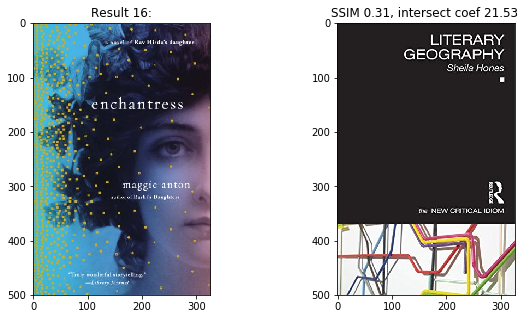

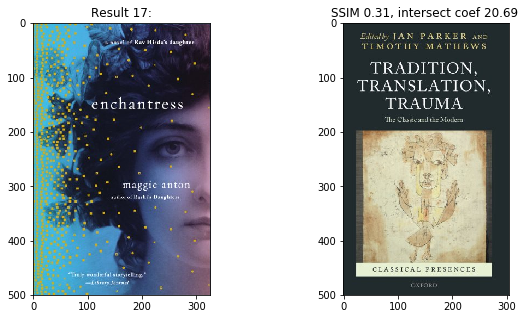

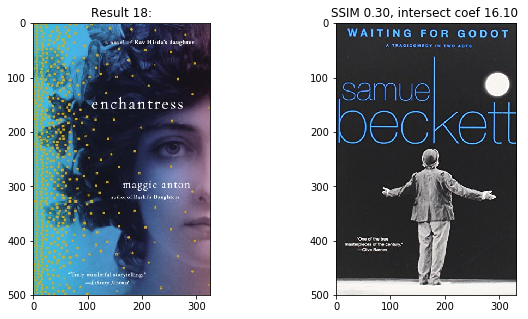

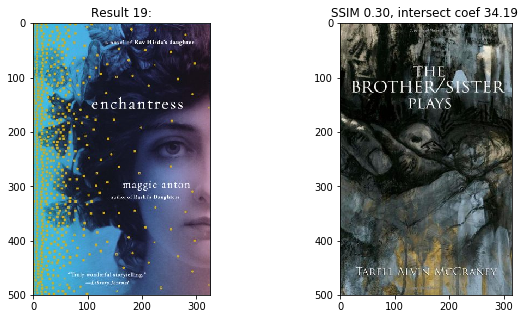

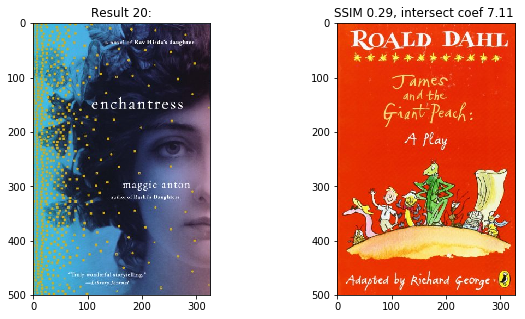

In [86]:
new_input = 'images/enchantress.jpg'
submit_img(new_input, data)

In [12]:
# Let's add the option for different histogram comparison Methods
def submit_img(path, images_to_compare, hist_comp='chi-square', intersect_max=80, ssim_max_threshold=None, results = None):    
    query = []

    query_img = cv2.imread(path)
    query_img = cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB)
    
    hist = cv2.calcHist([query_img], [0, 1, 2], None, [8, 8, 8],[0, 256, 0, 256, 0, 256])
    hist = cv2.normalize(hist, None)


    query.append((test_path,hist))
    
     #parameter to be updated by feed back

    color_matches = []
    
    for i in range(len(query)):
        matches = []
        
        if hist_comp.lower() == 'chi-square':

            for j in range(len(images_to_compare)):
                cmp = cv2.compareHist(query[i][1], images_to_compare[j][1], cv2.HISTCMP_CHISQR)

                if cmp <= intersect_max:
                    matches.append((cmp,images_to_compare[j][0]))

            matches.sort(key=lambda x : x[0] , reverse = False)# the lower the chi_sq the better
            
            
        elif hist_comp.lower() == 'bhattacharyya':

            for j in range(len(images_to_compare)):
                cmp = cv2.compareHist(query[i][1], images_to_compare[j][1], cv2.HISTCMP_BHATTACHARYYA)

                if cmp <= intersect_max:
                    matches.append((cmp,images_to_compare[j][0]))

            matches.sort(key=lambda x : x[0] , reverse = False)# the lower the bhattacharyya coeff the better
            
        elif hist_comp.lower() == 'correlation':

            for j in range(len(images_to_compare)):
                cmp = cv2.compareHist(query[i][1], images_to_compare[j][1], cv2.HISTCMP_CORREL)

                if cmp <= intersect_max:
                    matches.append((cmp,images_to_compare[j][0]))
            
            matches.sort(key=lambda x : x[0] , reverse = True)# the higher the correlation the better
            
        elif hist_comp.lower() == 'correlation':

            for j in range(len(images_to_compare)):
                cmp = cv2.compareHist(query[i][1], images_to_compare[j][1], cv2.HISTCMP_CORREL)

                if cmp <= intersect_max:
                    matches.append((cmp,images_to_compare[j][0]))
            
            matches.sort(key=lambda x : x[0] , reverse = True)# the higher the intersection the better
        color_matches.append((query[i][0],matches))

     # parameter to be updated by feedback
    
    final_matches = []

    for i in range(len(color_matches)):
        query_image_path = color_matches[i][0]
        matches = []
        for j in range(len(color_matches[i][1])):
            match_image_path = color_matches[i][1][j][1]

            si = get_similarity_index(query_image_path,match_image_path)
            
            if ssim_max_threshold:
                if si <= ssim_max_threshold:
                    color_sim_score = color_matches[i][1][j][0]

                    matches.append((si, color_sim_score, match_image_path))
            
            else:
                if si > 0:
                    color_sim_score = color_matches[i][1][j][0]

                    matches.append((si, color_sim_score, match_image_path))
        
        
        
        matches.sort(key=lambda x : x[0], reverse = True)

        start = int(input("enter starting results index "))
        final_matches_limit = start + 25
        final_matches.append((query_image_path,matches[start:final_matches_limit]))
    
    
    
    for i, match in enumerate(final_matches[0][1]):
        recc = cv2.imread(match[2])

        recc = cv2.cvtColor(recc, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.title('Result {}:'.format(i+1))
        plt.imshow(query_img)

        plt.subplot(1, 2, 2)
        plt.title("SSIM {:.2f}, intersect coef {:.2f} ".format(match[0],match[1]))
        plt.imshow(recc)
        
        if results: #store results in dict for furthering filtering
            results[str(i+1)] = match[2]

In [14]:
test_path = 'images/HDM.jpg'

enter starting results index 0


/usr/local/lib/python3.5/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


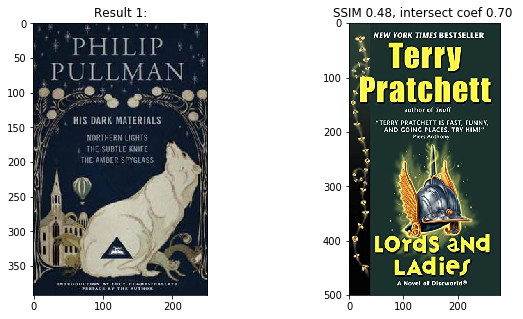

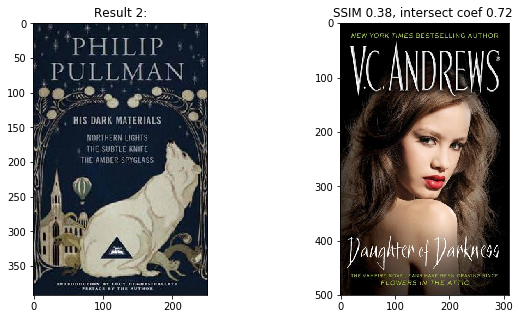

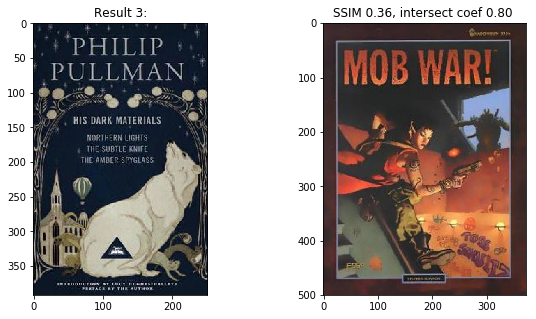

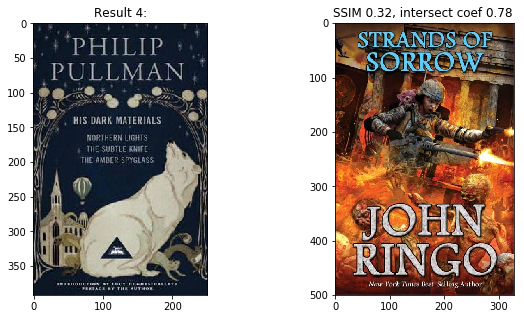

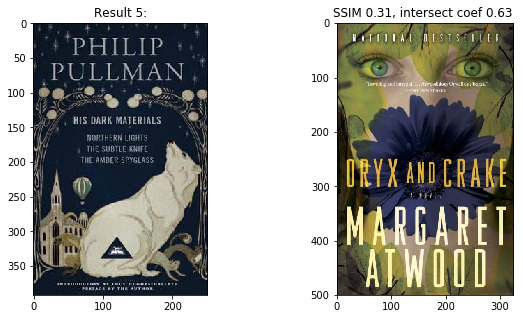

...

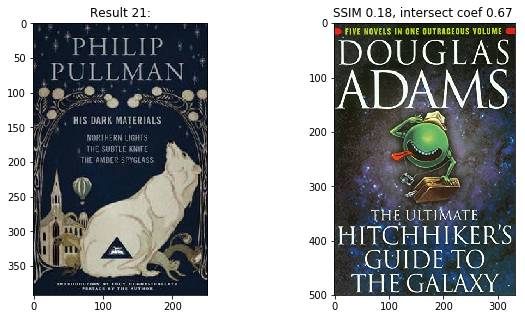

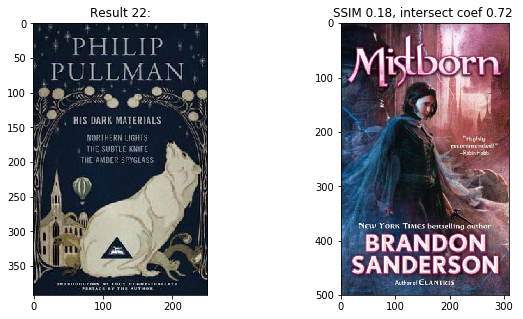

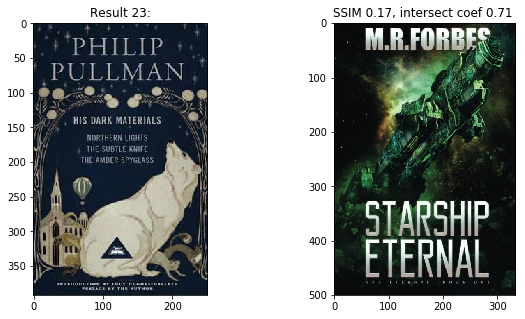

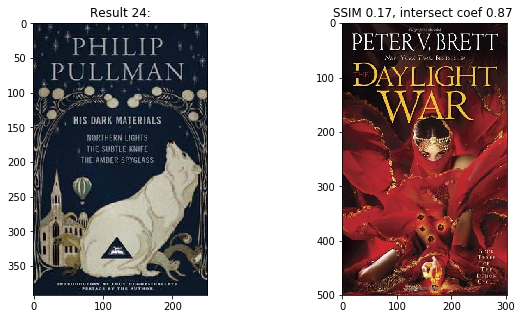

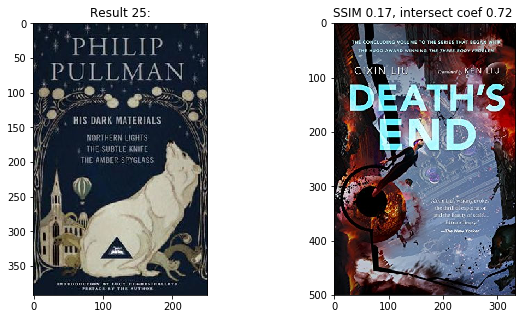

In [30]:
submit_img(test_path, data, hist_comp='bhattacharyya')

In [31]:
#data = load_hist_data('images/train_set/', ['SciFi-Fantasy'])
data = load_hist_data('images/test_set/', ['Literature & Fiction'])

190 images loaded


enter starting results index 0


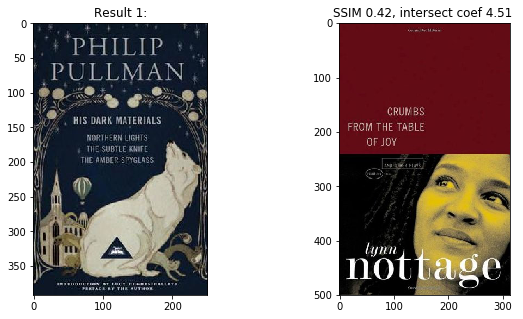

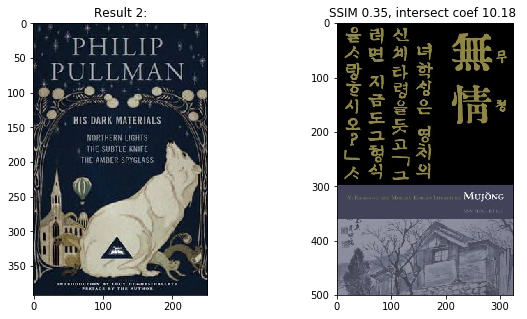

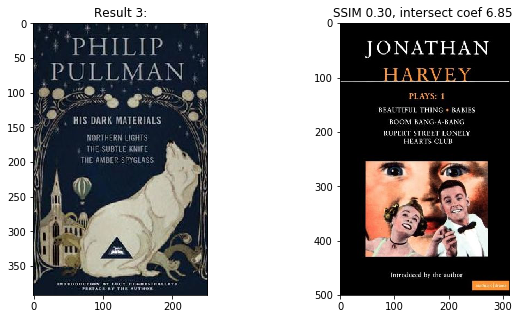

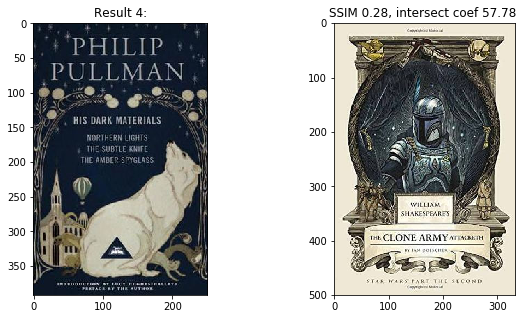

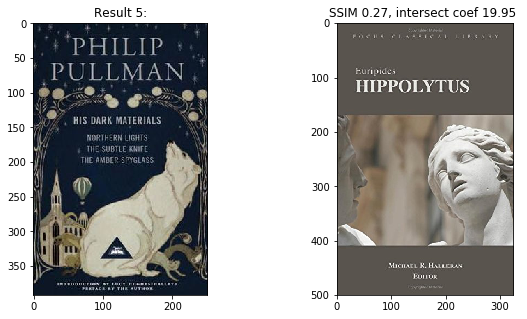

...

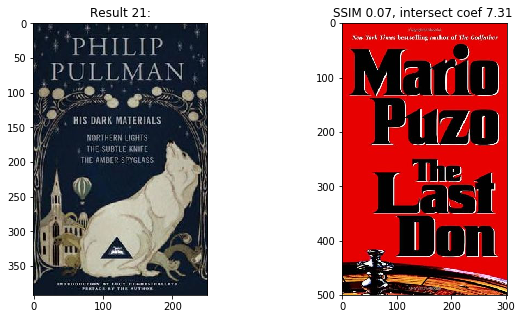

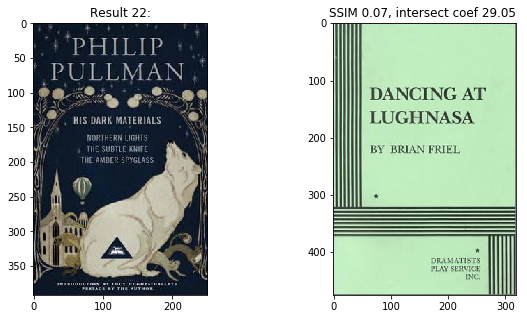

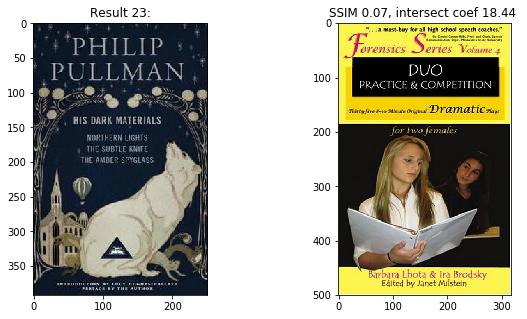

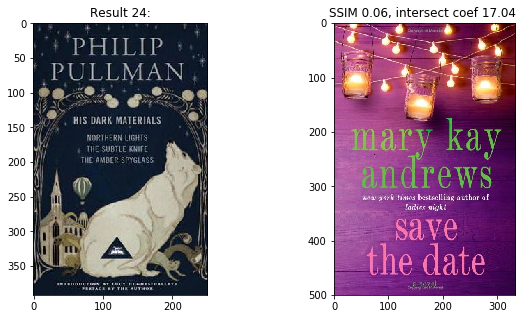

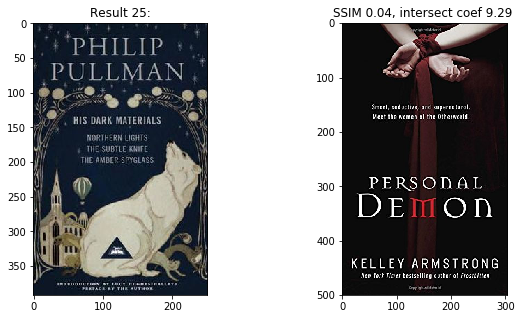

In [32]:
submit_img(test_path, data,)

##### Interesting, Not having Any info other than the cover makes Decisions and browsing simpler, less info to interpret means more purposeful browsing !!!
Having query img for side by side comparison makes all the difference!!!!!! Using larger samples will give more options. Tune with feedback weights and restrict pagination limits 
Furthermore the simplicity of the model (two level sorting based on different similarity metrics creat uneven distribution of images 'similarity scorces which makes it easy to scroll through and eliminate unappealing results)